In [1]:
import pandas as pd
import numpy as np
import os
import json
import pandas_datareader.data as web   # my local kernel Python 3.10.7 
import matplotlib.pyplot as plt  # unavailable?  do: 1. pip uninstall matplotlib # 2. python3 -m pip install matplotlib
%matplotlib inline
from matplotlib.ticker import (AutoMinorLocator, MultipleLocator)
import datetime
import io
pd.set_option('display.max_columns', None)
import warnings
import seaborn as sns
import scipy
from scipy import stats
warnings.filterwarnings("ignore")
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.model_selection import GridSearchCV
from sklearn.pipeline import Pipeline
import talib as ta


In [2]:
def from_Tick(csvFile, interval, chart):
    tit = str(csvFile).replace('C:\BidAskRepo\\', '').replace('older_repo2022\\', '').replace('Globex_', '').replace('.csv','').strip()
    # tit = str(csvFile).replace('C:\\BidAskRepo\\', '').replace(' Globex_', '_').replace('.csv','')
    periodGlobal = interval
    columns = ['DateTime', 'Vol', 'BidAsk', 'Bid', 'Ask', 'Price']
    mapping = {'AtBid': -1, 'AtAsk': 1, 'BelowBid': -2, 'AboveAsk': 2, 'BetweenBidAsk':0 }  
    l = pd.read_csv(csvFile, names = columns, index_col='DateTime', parse_dates= True)  
    l = l.replace({'BidAsk': mapping})
    l['Scaled'] = stats.zscore(l.Price)
    print('Shape: ', l.shape)
    del l['Ask']
    del l['Bid']
    if chart:
        ti = str(l.index[0])[0:10]
        # print('ti is: ', ti)  
        p1 = ti + ' 06:00:00'
        p2 = ti + ' 16:30:00'
        p11 = ti + ' 09:00:00'
        p12 = ti + ' 10:00:00'
        # print('p1, p2 are: ', p1, p2)
        l.loc[p1:p2].plot(y='Scaled', figsize=(16,4)) 
        ti = str(l.index[0])[0:10]
        plt.title(tit)
        plt.axhline(y= l.loc[p11 : p12]['Scaled'].max(), xmin = 0.32, xmax = 0.92, color = 'blue', linestyle = 'dashed', label="Open-High", alpha=0.3)
        plt.axhline(y= l.loc[p11 : p12]['Scaled'].min(), xmin = 0.32, xmax = 0.92, color = 'red', linestyle = 'dashed', label="Open-Low", alpha=0.3)
        plt.axhline(y= 0, xmin = 0.99, xmax = 0.001, color = 'black', linestyle = 'dashed', label="0", linewidth= 1)
        plt.axvline(x=  ti + ' 07:00:00')
        plt.axvline(x=  ti + ' 09:30:00', ymax = 1, linewidth= 1.5, color='red', alpha=0.7)
        plt.axvline(x=  ti + ' 10:00:00', ymax = 1, linewidth= 1.5, color='red', alpha=0.7)
        plt.axvline(x=  ti + ' 09:45:00', ymax = 1, linewidth= 45, color='blue', alpha=0.2)
        plt.axvline(x=  ti + ' 11:00:00', ymax = 1, linewidth= 1.5, color='b', alpha=0.1)
        plt.axvline(x=  ti + ' 11:10:00', ymax = 1, linewidth= 1.5, color='b', alpha=0.1)
        plt.axvline(x=  ti + ' 11:20:00', ymax = 1, linewidth= 1.5, color='b', alpha=0.1)
        plt.axvline(x=  ti + ' 11:30:00', ymax = 1, linewidth= 1.5, color='b', alpha=0.1)
        plt.axvline(x=  ti + ' 12:00:00', ymax = 1, linewidth= 1.5, color='b', alpha=0.1)
        plt.axvline(x=  ti + ' 13:00:00', ymax = 1, linewidth= 1.5, color='b', alpha=0.1)
        plt.axvline(x=  ti + ' 14:00:00', ymax = 1, linewidth= 1.5, color='b', alpha=0.1)
        plt.axvline(x=  ti + ' 15:00:00', ymax = 1, linewidth= 1.5, color='b', alpha=0.1)
        plt.axvline(x=  ti + ' 16:00:00', color= 'red')
        plt.grid()
    return l

In [339]:
def charting(l, vwap, xstr):
    ti = str(l.index[0])[0:10]
    # print('ti is: ', ti)
    xs = xstr  
    p1 = ti + ' 04:00:00'
    p2 = ti + ' 16:30:00'
    p11 = ti + ' 09:00:00'
    p12 = ti + ' 10:00:00'
    # print('p1, p2 are: ', p1, p2)
    # print('xstr is: ', xstr)
    if vwap:
        l.loc[p1:p2].plot(y= ['closeScl', 'vwapS'], figsize= (16, 4))  
        # tit = str(l.index[0])[:10]
        # print('tit is: ', tit)
        plt.title(xs)
        plt.axhline(y= l.loc[p11 : p12]['closeScl'].max(), xmin = 0.32, xmax = 0.92, color = 'blue', linestyle = 'dashed', label="Open-High", alpha= 0.3)
        plt.axhline(y= l.loc[p11 : p12]['closeScl'].min(), xmin = 0.32, xmax = 0.92, color = 'red', linestyle = 'dashed', label="Open-Low", alpha= 0.3)
        plt.axhline(y= 0, xmin = 0.99, xmax = 0.001, color = 'black', linestyle = 'dashed', label="0", linewidth= 1)
        plt.axvline(x=  ti + ' 07:00:00')
        plt.axvline(x=  ti + ' 09:30:00', ymax = 1, linewidth= 1.5, color='red', alpha=0.7)
        plt.axvline(x=  ti + ' 10:00:00', ymax = 1, linewidth= 1.5, color='red', alpha=0.7)
        plt.axvline(x=  ti + ' 09:45:00', ymax = 1, linewidth= 70, color='blue', alpha=0.2)
        plt.axvline(x=  ti + ' 11:00:00', ymax = 1, linewidth= 1.5, color='b', alpha=0.1)
        plt.axvline(x=  ti + ' 11:10:00', ymax = 1, linewidth= 1.5, color='b', alpha=0.1)
        plt.axvline(x=  ti + ' 11:20:00', ymax = 1, linewidth= 1.5, color='b', alpha=0.1)
        plt.axvline(x=  ti + ' 11:30:00', ymax = 1, linewidth= 1.5, color='b', alpha=0.1)
        plt.axvline(x=  ti + ' 12:00:00', ymax = 1, linewidth= 1.5, color='b', alpha=0.1)
        plt.axvline(x=  ti + ' 13:00:00', ymax = 1, linewidth= 1.5, color='b', alpha=0.1)
        plt.axvline(x=  ti + ' 14:00:00', ymax = 1, linewidth= 1.5, color='b', alpha=0.1)
        plt.axvline(x=  ti + ' 15:00:00', ymax = 1, linewidth= 1.5, color='b', alpha=0.1)
        plt.axvline(x=  ti + ' 16:00:00', color= 'red')
        # plt.grid()
        return plt.grid()
    
    l.loc[p1:p2].plot(y= ['closeScl'], figsize=(16,4))
    tit = str(l.index[0])[:10]
    # print('tit is: ', tit)
    plt.title(xs)
    plt.axhline(y= l.loc[p11 : p12]['closeScl'].max(), xmin = 0.32, xmax = 0.92, color = 'blue', linestyle = 'dashed', label="Open-High", alpha=0.3)
    plt.axhline(y= l.loc[p11 : p12]['closeScl'].min(), xmin = 0.32, xmax = 0.92, color = 'red', linestyle = 'dashed', label="Open-Low", alpha=0.3)
    plt.axhline(y= 0, xmin = 0.99, xmax = 0.001, color = 'black', linestyle = 'dashed', label="0", linewidth= 1)
    plt.axvline(x=  ti + ' 07:00:00')
    plt.axvline(x=  ti + ' 09:30:00', ymax = 1, linewidth= 1.5, color='red', alpha=0.7)
    plt.axvline(x=  ti + ' 10:00:00', ymax = 1, linewidth= 1.5, color='red', alpha=0.7)
    plt.axvline(x=  ti + ' 09:45:00', ymax = 1, linewidth= 70, color='blue', alpha=0.2)
    plt.axvline(x=  ti + ' 11:00:00', ymax = 1, linewidth= 1.5, color='b', alpha=0.1)
    plt.axvline(x=  ti + ' 11:10:00', ymax = 1, linewidth= 1.5, color='b', alpha=0.1)
    plt.axvline(x=  ti + ' 11:20:00', ymax = 1, linewidth= 1.5, color='b', alpha=0.1)
    plt.axvline(x=  ti + ' 11:30:00', ymax = 1, linewidth= 1.5, color='b', alpha=0.1)
    plt.axvline(x=  ti + ' 12:00:00', ymax = 1, linewidth= 1.5, color='b', alpha=0.1)
    plt.axvline(x=  ti + ' 13:00:00', ymax = 1, linewidth= 1.5, color='b', alpha=0.1)
    plt.axvline(x=  ti + ' 14:00:00', ymax = 1, linewidth= 1.5, color='b', alpha=0.1)
    plt.axvline(x=  ti + ' 15:00:00', ymax = 1, linewidth= 1.5, color='b', alpha=0.1)
    plt.axvline(x=  ti + ' 16:00:00', color= 'red')
    return plt.grid()

In [132]:
def resample_Scaled(col, interval):
    s =  col.resample(interval).ohlc(_method= 'ohlc')                 
    # print('Scaled before is: ', s.head())
    s.set_axis(['openScl', 'highScl', 'lowScl', 'closeScl'], axis= 1, inplace= True)
    # print('Scaled after is: ', s.head())
    return s
    
def resample_Price(frame, interval):
    # use L for millisec, U for microsec, and S for seconds, Min for minutes
     df = frame['Price'].resample(interval).ohlc(_method='ohlc')
    #  print(df.shape)
     return df
 
def resample_Sum(col, interval):
    #  use L for millisec, U for microsec, S for seconds, Min for minutes 
    c = col.resample(interval).sum()
    # print(c.shape)
    return c

def combine_V_BA(v, ba, interval):
    fr = pd.concat([resample_Sum(v, interval), resample_Sum(ba, interval)], axis= 1)
    return fr

def allFrame(a, b):
    fr = pd.concat([a,b], axis= 1)
    return fr

In [86]:
def from_Tick(csvFile, interval, chart):
    # tit = str(csvFile).replace('C:\\BidAskRepo\\', '').replace(' Globex_', '').replace('.csv','')
    periodGlobal = interval
    columns = ['DateTime', 'Vol', 'BidAsk', 'Bid', 'Ask', 'Price']
    mapping = {'AtBid': -1, 'AtAsk': 1, 'BelowBid': -2, 'AboveAsk': 2, 'BetweenBidAsk':0 }  
    l = pd.read_csv(csvFile, names = columns, index_col='DateTime', parse_dates= True)  
    l = l.replace({'BidAsk': mapping})
    del l['Ask']
    del l['Bid']
    return l

In [348]:
def from_Tick2(file, interval, chart, table, shape, info, describe, vwap, xstr):   #   Vol  BidAsk    Price    Scaled
    n = ['DateTime',  'Vol',  'BidAsk',  'Price' , 'Scaled']
    # df2 = df1.set_axis(['open', 'high', 'low', 'close', 'OpenScl', 'HighScL', 'LowScl', 'CloseScl'], axis=1, inplace= False)
    mapping = {'AtBid': -1, 'AtAsk': 1, 'BelowBid': -2, 'AboveAsk': 2, 'BetweenBidAsk':0 }  
    df = pd.read_csv(file, parse_dates= True, header = 0, names= n, index_col= [0]) 
    df.replace({'BidAsk': mapping}, inplace=True)
    
    df['Scaled'] = stats.zscore(df.Price)
    
    # print('DF columns are: ', df.columns, df.head())    
    # print(df.Scaled)
    ohlc = resample_Price(df, interval)
    # print(ohlc.head())
    s = resample_Scaled(df.Scaled , interval)
    ohlsS = allFrame(ohlc, s)
    # print('ohlsS is ', ohlsS.head())
    
    vol = resample_Sum(df.Vol, interval)
    # print('Vol is ', vol.head())
    
    ohlsSV = allFrame(ohlsS, vol)
    # print('ohlsSV is', ohlsSV.columns)
    
    bidask = resample_Sum(df.BidAsk, interval)
    
    ohlsSV_BA = allFrame(ohlsSV, bidask)
    ohlsSV_BA['vwap'] = (ohlsSV_BA.Vol * (ohlsSV_BA.high + ohlsSV_BA.low) / 2).cumsum() / ohlsSV_BA.Vol.cumsum()   
    ohlsSV_BA['vwapS'] = (ohlsSV_BA.Vol * (ohlsSV_BA.highScl + ohlsSV_BA.lowScl) / 2).cumsum() / ohlsSV_BA.Vol.cumsum() 
    
    # print(ohlsSV_BA.head(), ohlsSV_BA.shape, ohlsSV_BA.columns)
    df_session = ohlsSV_BA.between_time('04:20:00', '16:20:00').interpolate(method='linear')
    
    if chart:
        cha = charting(df_session, vwap, xstr)
        # print(cha)
    if shape:
        print('Shape: ', df_session.shape)     #   (68, 4)
    if table:
        print(df_session.head())
    if info:
        print(df_session.info())
    if describe:
        print(df_session.describe())
              
    df_session = df_session.resample('2T').asfreq().interpolate(method='linear')
    
    return df_session 

In [97]:
f = r"C:\Repo1\ES 03-23 2022_12_08.csv"         #   DateTime,Vol,BidAsk,Price, Scaled       "C:\Repo1" 
# f = r'C:\BidAskRepo\NQ 12-22 Globex_2022_11_22.csv'        
#  DateTime,Vol,BidAsk,Bid, Ask , Price,       2022-11-22 00:00:01,1,AtAsk,11604.25,11604.5,11604.5
# df.head()

In [ ]:
s = 'C:\\Repo1\\ES 03-23 2022_12_08.csv'
var_holder[0]
xstr = str(var_holder[x])[9:22]
df = from_Tick2(f, '10T', True, False, False, False, False, True)
# df.head()      #   open	  high	 low	close
# df.shape       #   (1440, 4)


In [261]:
# create a sample dataframe
# boo  = pd.DataFrame({'value': [1, None, 3, None, 23,56,1,5,6,7, None, 9, None, 8,3,2,4,5,6,None]}, index=pd.date_range('2022-01-01', periods=20, freq='2min'))
# boo = boo.drop(['2022-01-01 00:22:00'])	#56.0
boo.shape

(16, 1)

In [ ]:
# test for resampling with linear interpolation
boo1  = boo.resample('1T').asfreq().interpolate(method='linear')

print(boo1)

In [226]:
#----------get directory of csv and make list   we need:  # to_df_OHLC('C:\\BidAskRepo\\ES 03-23 Globex_2022_12_06.csv' , '1Min', True)  
repo = []
import os
path = "C:\Repo1"
dd = os.listdir(path)
dd.sort()
# print('Length is : ', len(dd))  #     95      180
#----------deal with string of file ------------

for i in range(len(dd)):    
    from pathlib import Path
    data_folder = Path("C:\Repo1") 
    file_to_open = data_folder/str(dd[i])
    repo.append(file_to_open.__str__())
   
print(len(repo)) # 260 (from 270 after discarding Holidays & Partal Days)

260


In [ ]:
#  Loop through repo of 100 from 255charts   
#  from_Tick2(file, interval, chart, table, shape, info, describe, vwap, xstr):
import os
var_holder = {}    
# if not os.path.exists('2MinScaled'):
#     os.makedirs('2MinScaled') 
             
for i in range(0, 2 ):             #(1, len(repo)):  
    
    x = repo[i].replace('C:\BidAskRepo\\', '').replace('Globex_', '').replace('.csv','').strip()
    # var_holder[x] = x
    # print('x is: ', x)
    # x = str(var_holder[x])[9:22]
    # print('xstr is: ', xstr)
    file_ = x[9:]
    # print('file_ is: ', file_)
    var_holder[x] = from_Tick2(repo[i], '2T', True, False, True,  False, False, True, x)

    # var_holder[x].to_csv('C:\2MinScaled\' + .csv')   # "C:\2MinScaled"
    filename = f'{file_}{i}.csv'

    var_holder[x].to_csv(os.path.join(os.getcwd(), filename), index= True)

In [369]:
# counting files in folders 
# folder = r"C:\2MinScaled\2MinBalancedScaled\U"
# repo1 = []

# path = folder 
# dfold = os.listdir(path)

# for i in range(len(dfold)):    
#     from pathlib import Path
#     data_folder1 = Path(folder) 
#     file_to_open = data_folder1/str(dfold[i])
#     repo1.append(file_to_open.__str__())
   
# print(len(repo1))


56


var_holder[x]  C:\Repo1\ES03-232022_12_06
xstr is:  ES03-232022_1


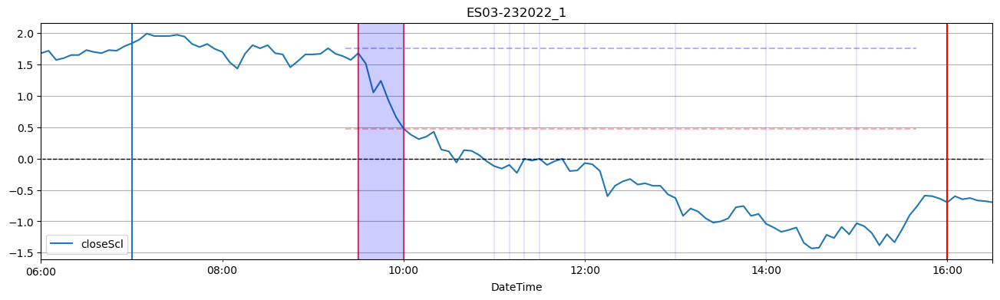

In [221]:
# test for chart and procedure for conversion of datasets 
var_holder = {}               
for i in range(1, 2):
    x = repo[i].replace('C:\BidAskRepo\\', '').replace(' ', '').replace('Globex_','_').replace('.csv', '').strip() 
    var_holder[x] = x
    # print('x is:', x)
    xstr = str(var_holder[x])[9:22]
    # print('xstr is:', xstr)    #      xstr is:  ES03-232022_1
    # var_holder[x] = to_df_OHLC(repo[i], '15Min', True, True)
    print('var_holder[x] ', var_holder[x])
    var_holder[x] = from_Tick2(repo[i], '5T', True, False, False, False, False, False, xstr)
    var_holder[x].to_csv('C:\\15Min\\' + xstr + '.csv')

#### Plot & Convert 255 charts from tick csv files to 2 min df's;
 - with no missing values and linear interpolation imputing;
 - with charitnt vertical/horizontal lines at crucial hours of the day;
 - with balanced hours of operation;
 - with balanced number of rows;
 - with scaling OHLC & VWAP 
 - with exporting them to balanced csv files

Shape:  (361, 12)
Shape:  (314, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (361, 12)
Shape:  (3

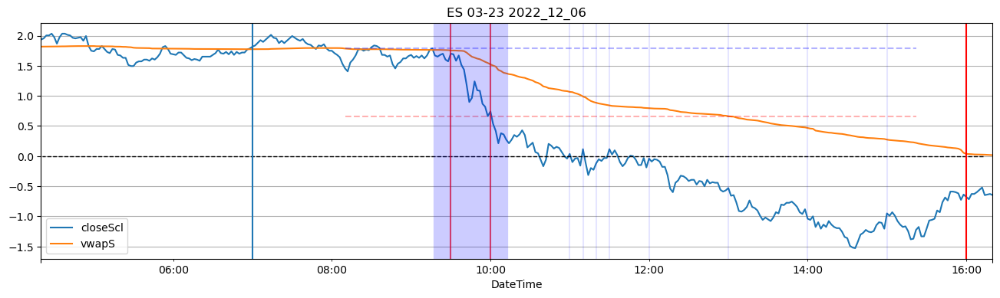

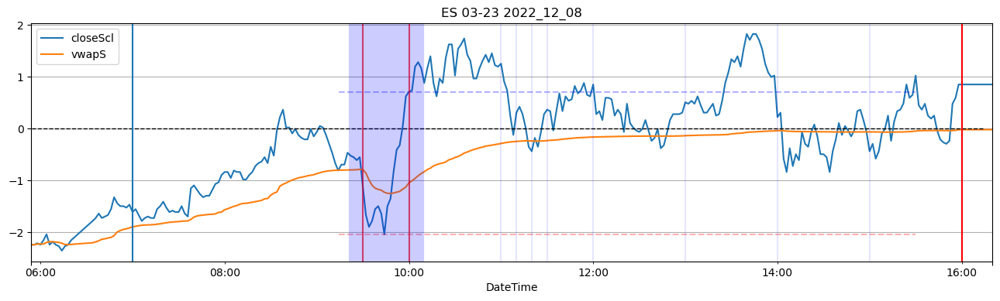

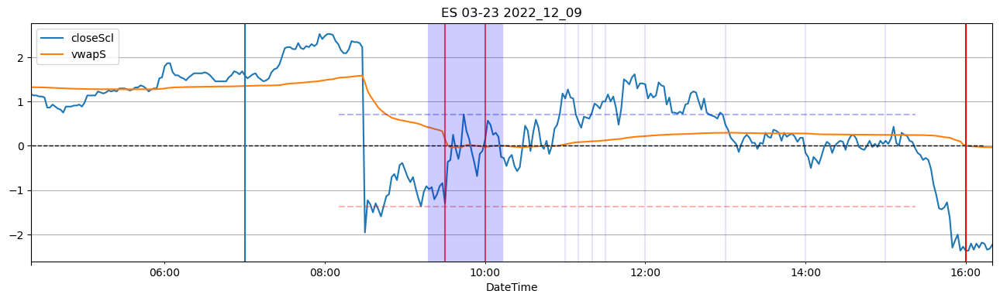

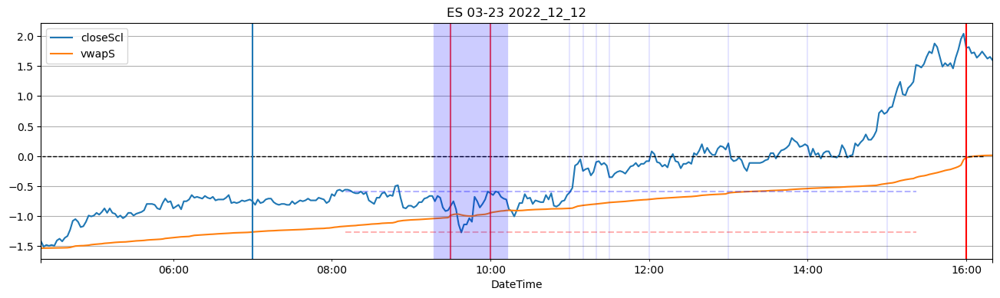

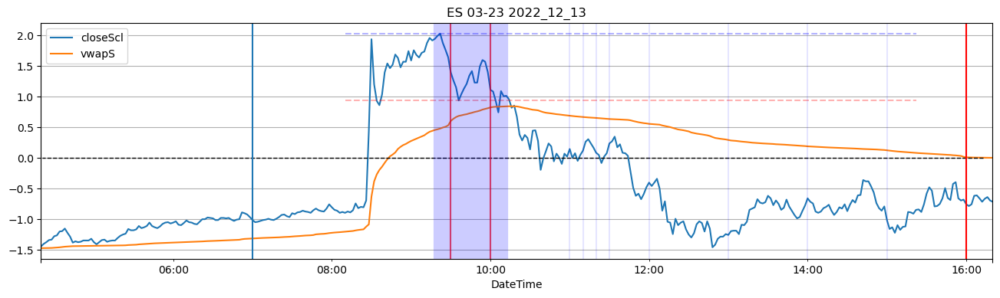

...

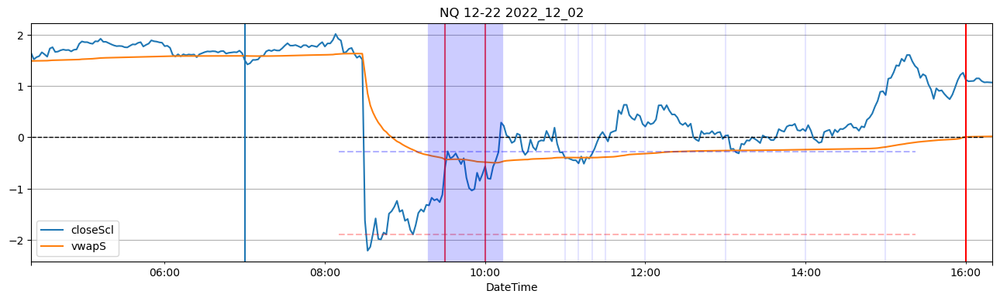

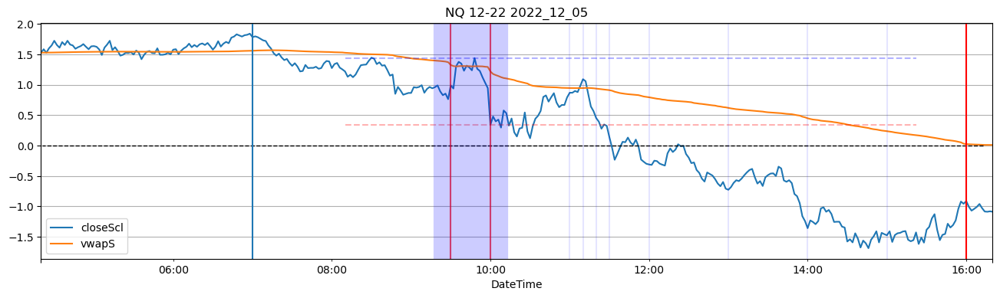

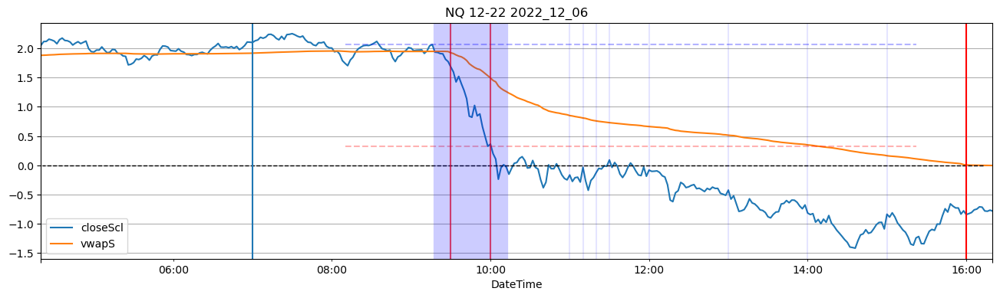

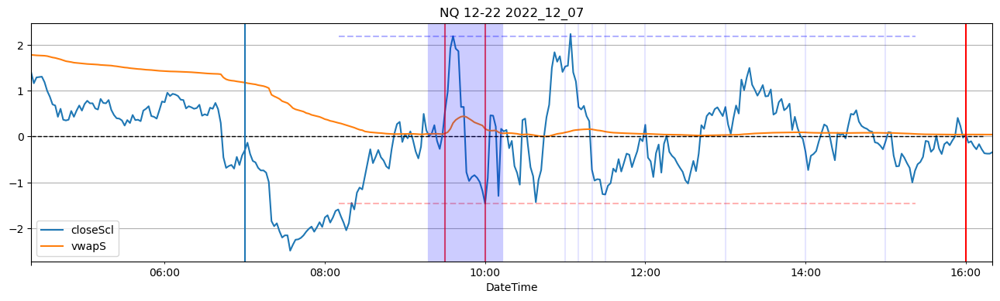

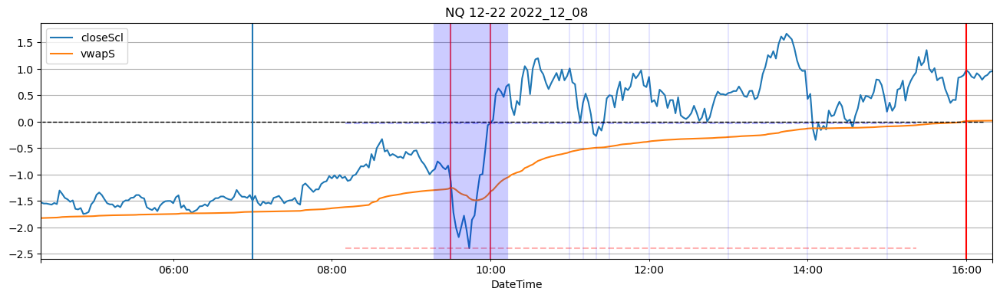

In [363]:
# second batch sets
var_holder = {}               
for i in range(1, len(repo)):
    x = repo[i].replace('C:\BidAskRepo\\', '').replace(' ', '').replace('Globex_','_').replace('.csv', '').strip() 
    var_holder[x] = x
    # print('x is:', x)
    # print('Name is: ', repo[i][9:-4])
    xstr = repo[i][9:-4]     
    # print('xstr is:', xstr)    #      xstr is:  ES03-232022_1
    # var_holder[x] = to_df_OHLC(repo[i], '15Min', True, True)
    # print('var_holder[x] ', var_holder[x])
    var_holder[x] = from_Tick2(repo[i], '2T', True, False, True, False, False, True, xstr)
    var_holder[x].to_csv('C:\\2MinScaled\\' + xstr + '.csv')